In [ ]:
import os
import time
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import clear_output
import random
import io
import requests
import zipfile
import urllib.request

# Import PyTorch libraries
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from torchvision.utils import make_grid, save_image
from PIL import Image


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

Using device: cuda


In [ ]:
def download_and_extract_dataset():
    print("Downloading maps dataset...")

    # Create temp directory for data
    if not os.path.exists("datasets"):
        os.makedirs("datasets")
    if not os.path.exists("datasets/maps"):
        os.makedirs("datasets/maps")

    # Direct download using urllib instead
    url = "http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz"
    file_path = "datasets/maps.tar.gz"

    try:
        # Download the file
        urllib.request.urlretrieve(url, file_path)
        print(f"Downloaded to {file_path}")

        # Extract using os command (more reliable for large tar.gz files)
        print("Extracting dataset...")
        import subprocess
        subprocess.run(["tar", "-xzf", file_path, "-C", "datasets/"])
        print("Dataset extracted!")

    except Exception as e:
        print(f"Error downloading/extracting: {e}")

        # Fallback: Let's use the pix2pix facades dataset which is often more reliable
        print("Trying alternative dataset (facades)...")
        url = "http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/facades.tar.gz"
        file_path = "datasets/facades.tar.gz"

        try:
            urllib.request.urlretrieve(url, file_path)
            subprocess.run(["tar", "-xzf", file_path, "-C", "datasets/"])
            print("Facades dataset extracted as fallback!")
            return "datasets/facades"
        except Exception as e2:
            print(f"Error with fallback dataset: {e2}")

            # Second fallback - create a dummy dataset for demonstration
            print("Creating minimal sample dataset for demonstration")
            os.makedirs("datasets/maps/train", exist_ok=True)
            os.makedirs("datasets/maps/val", exist_ok=True)
            # Download a few sample images directly
            sample_urls = [
                "https://eecs.berkeley.edu/~tinghuiz/projects/pix2pix/pix2pix_examples/maps/input_1.jpg",
                "https://eecs.berkeley.edu/~tinghuiz/projects/pix2pix/pix2pix_examples/maps/input_2.jpg"
            ]
            for i, url in enumerate(sample_urls):
                try:
                    urllib.request.urlretrieve(url, f"datasets/maps/train/sample_{i}.jpg")
                    urllib.request.urlretrieve(url, f"datasets/maps/val/sample_{i}.jpg")
                except:
                    print(f"Could not download sample {i}")

    return "datasets/maps"

In [ ]:
class MapsDataset(Dataset):
    def __init__(self, root_dir, phase='train', transform=None):
        self.root_dir = os.path.join(root_dir, phase)
        self.transform = transform
        self.image_filenames = [f for f in os.listdir(self.root_dir) if f.endswith('.jpg')]
        print(f"Found {len(self.image_filenames)} images in {self.root_dir}")

    def __len__(self):
        return len(self.image_filenames)

    def __getitem__(self, idx):
        img_name = os.path.join(self.root_dir, self.image_filenames[idx])
        image = Image.open(img_name)

        # Original image is 600x1200 (aerial and map side by side)
        width, height = image.size
        satellite_img = image.crop((0, 0, width//2, height))  # Left half is satellite
        map_img = image.crop((width//2, 0, width, height))    # Right half is map

        if self.transform:
            satellite_img = self.transform(satellite_img)
            map_img = self.transform(map_img)

        return {'A': satellite_img, 'B': map_img}

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features)
        )

    def forward(self, x):
        return x + self.block(x)

In [ ]:
class Generator(nn.Module):
    def __init__(self, input_channels, output_channels, n_residual_blocks=9):
        super(Generator, self).__init__()

        # Initial convolution block
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(input_channels, 64, 7),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True)
        ]

        # Downsampling
        in_features = 64
        out_features = in_features * 2
        for _ in range(2):
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features * 2

        # Residual blocks
        for _ in range(n_residual_blocks):
            model += [ResidualBlock(in_features)]

        # Upsampling
        out_features = in_features // 2
        for _ in range(2):
            model += [
                nn.ConvTranspose2d(in_features, out_features, 3, stride=2, padding=1, output_padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features
            out_features = in_features // 2

        # Output layer
        model += [
            nn.ReflectionPad2d(3),
            nn.Conv2d(64, output_channels, 7),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, input_channels):
        super(Discriminator, self).__init__()

        # A series of convolutions with increasing depth
        model = [
            nn.Conv2d(input_channels, 64, 4, stride=2, padding=1),
            nn.LeakyReLU(0.2, inplace=True)
        ]

        model += [
            nn.Conv2d(64, 128, 4, stride=2, padding=1),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True)
        ]

        model += [
            nn.Conv2d(128, 256, 4, stride=2, padding=1),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True)
        ]

        # FCN classification layer
        model += [
            nn.Conv2d(256, 512, 4, padding=1),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True)
        ]

        model += [nn.Conv2d(512, 1, 4, padding=1)]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)


In [ ]:
class ReplayBuffer:
    def __init__(self, max_size=50):
        self.max_size = max_size
        self.data = []

    def push_and_pop(self, data):
        to_return = []
        for element in data.detach():
            element = torch.unsqueeze(element, 0)
            if len(self.data) < self.max_size:
                self.data.append(element)
                to_return.append(element)
            else:
                if random.uniform(0, 1) > 0.5:
                    i = random.randint(0, self.max_size-1)
                    to_return.append(self.data[i].clone())
                    self.data[i] = element
                else:
                    to_return.append(element)
        return torch.cat(to_return)


In [ ]:
class LossFunctions:
    def __init__(self):
        self.MSE = nn.MSELoss()
        self.L1 = nn.L1Loss()

    def gan_loss(self, output, target):
        return self.MSE(output, target)

    def cycle_loss(self, reconstructed, real):
        return self.L1(reconstructed, real)

    def identity_loss(self, output, target):
        return self.L1(output, target)


In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, 'bias') and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find('BatchNorm2d') != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

# Helper function to save image grid
def save_image_grid(tensor, filename, nrow=8):
    # Denormalize images: [-1, 1] -> [0, 1]
    tensor = (tensor + 1) / 2

    grid = make_grid(tensor, nrow=nrow, padding=2, normalize=False)

    # Convert to numpy for display
    grid_np = grid.cpu().permute(1, 2, 0).numpy()

    # Save the image
    plt.figure(figsize=(15, 15))
    plt.imshow(grid_np)
    plt.axis('off')
    plt.savefig(filename)
    plt.close()

    # Also display the image
    plt.figure(figsize=(15, 15))
    plt.imshow(grid_np)
    plt.axis('off')
    plt.show()

# Training function
def train_cyclegan(dataloader, dataset_name, num_epochs=20):
    # Networks
    G_AB = Generator(3, 3).to(device)  # Satellite to Map
    G_BA = Generator(3, 3).to(device)  # Map to Satellite
    D_A = Discriminator(3).to(device)  # Discriminator for Satellite
    D_B = Discriminator(3).to(device)  # Discriminator for Map

    # Initialize weights
    G_AB.apply(weights_init_normal)
    G_BA.apply(weights_init_normal)
    D_A.apply(weights_init_normal)
    D_B.apply(weights_init_normal)

    # Define optimizers
    optimizer_G = torch.optim.Adam(
        list(G_AB.parameters()) + list(G_BA.parameters()),
        lr=0.0002, betas=(0.5, 0.999)
    )
    optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
    optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

    # Learning rate schedulers
    lr_scheduler_G = torch.optim.lr_scheduler.LambdaLR(
        optimizer_G, lr_lambda=lambda epoch: 1.0 - max(0, epoch - num_epochs//2) / float(num_epochs//2)
    )
    lr_scheduler_D_A = torch.optim.lr_scheduler.LambdaLR(
        optimizer_D_A, lr_lambda=lambda epoch: 1.0 - max(0, epoch - num_epochs//2) / float(num_epochs//2)
    )
    lr_scheduler_D_B = torch.optim.lr_scheduler.LambdaLR(
        optimizer_D_B, lr_lambda=lambda epoch: 1.0 - max(0, epoch - num_epochs//2) / float(num_epochs//2)
    )

    # Loss function
    criterion = LossFunctions()

    # Buffers of previously generated samples
    fake_A_buffer = ReplayBuffer()
    fake_B_buffer = ReplayBuffer()

    # Directories for storing results
    os.makedirs(f"images/{dataset_name}", exist_ok=True)
    os.makedirs(f"saved_models/{dataset_name}", exist_ok=True)

    # Lists to store loss values
    G_losses = []
    D_A_losses = []
    D_B_losses = []

    # For generating sample images
    sample_A = None
    sample_B = None

    # Training loop
    for epoch in range(num_epochs):
        start_time = time.time()

        for i, batch in enumerate(dataloader):
            # Set model input
            real_A = batch['A'].to(device)  # Satellite images
            real_B = batch['B'].to(device)  # Map images

            # Store sample images for visualization
            if i == 0 and sample_A is None:
                sample_A = real_A[:5].clone()
                sample_B = real_B[:5].clone()

                with torch.no_grad():
                  d_out = D_A(real_A)  # Get output size from discriminator
                  d_out_size = d_out.size()

# Real and fake labels with matching size
                  real_label = torch.ones(d_out_size).to(device)
                  fake_label = torch.zeros(d_out_size).to(device)

            ###### Train Generators ######
            optimizer_G.zero_grad()

            # Identity loss
            # G_BA(B) should equal B if real B is fed
            same_B = G_AB(real_B)
            identity_loss_B = criterion.identity_loss(same_B, real_B) * 5.0

            # G_AB(A) should equal A if real A is fed
            same_A = G_BA(real_A)
            identity_loss_A = criterion.identity_loss(same_A, real_A) * 5.0

            # GAN loss for G_AB and G_BA
            fake_B = G_AB(real_A)
            pred_fake_B = D_B(fake_B)
            loss_GAN_AB = criterion.gan_loss(pred_fake_B, real_label)

            fake_A = G_BA(real_B)
            pred_fake_A = D_A(fake_A)
            loss_GAN_BA = criterion.gan_loss(pred_fake_A, real_label)

            # Cycle loss
            # Forward cycle: A -> B -> A
            recovered_A = G_BA(fake_B)
            cycle_loss_ABA = criterion.cycle_loss(recovered_A, real_A) * 10.0

            # Backward cycle: B -> A -> B
            recovered_B = G_AB(fake_A)
            cycle_loss_BAB = criterion.cycle_loss(recovered_B, real_B) * 10.0

            # Total generator loss
            loss_G = (identity_loss_A + identity_loss_B +
                     loss_GAN_AB + loss_GAN_BA +
                     cycle_loss_ABA + cycle_loss_BAB)

            loss_G.backward()
            optimizer_G.step()

            ###### Train Discriminator A ######
            optimizer_D_A.zero_grad()

            # Real loss
            pred_real_A = D_A(real_A)
            loss_D_real_A = criterion.gan_loss(pred_real_A, real_label)

            # Fake loss (using buffer for stability)
            fake_A_buffered = fake_A_buffer.push_and_pop(fake_A)
            pred_fake_buffered_A = D_A(fake_A_buffered.detach())
            loss_D_fake_A = criterion.gan_loss(pred_fake_buffered_A, fake_label)

            # Total discriminator loss
            loss_D_A = (loss_D_real_A + loss_D_fake_A) * 0.5
            loss_D_A.backward()
            optimizer_D_A.step()

            ###### Train Discriminator B ######
            optimizer_D_B.zero_grad()

            # Real loss
            pred_real_B = D_B(real_B)
            loss_D_real_B = criterion.gan_loss(pred_real_B, real_label)

            # Fake loss (using buffer for stability)
            fake_B_buffered = fake_B_buffer.push_and_pop(fake_B)
            pred_fake_buffered_B = D_B(fake_B_buffered.detach())
            loss_D_fake_B = criterion.gan_loss(pred_fake_buffered_B, fake_label)

            # Total discriminator loss
            loss_D_B = (loss_D_real_B + loss_D_fake_B) * 0.5
            loss_D_B.backward()
            optimizer_D_B.step()

            # Print statistics
            if i % 50 == 0:
                print(f"[Epoch {epoch+1}/{num_epochs}] [Batch {i}/{len(dataloader)}] "
                      f"[D_A loss: {loss_D_A.item():.4f}] [D_B loss: {loss_D_B.item():.4f}] "
                      f"[G loss: {loss_G.item():.4f}]")

                # Store losses for plotting
                G_losses.append(loss_G.item())
                D_A_losses.append(loss_D_A.item())
                D_B_losses.append(loss_D_B.item())

        # Update learning rates
        lr_scheduler_G.step()
        lr_scheduler_D_A.step()
        lr_scheduler_D_B.step()

        # Save models (checkpoint)
        if (epoch + 1) % 5 == 0:
            torch.save(G_AB.state_dict(), f"saved_models/{dataset_name}/G_AB_{epoch+1}.pth")
            torch.save(G_BA.state_dict(), f"saved_models/{dataset_name}/G_BA_{epoch+1}.pth")
            torch.save(D_A.state_dict(), f"saved_models/{dataset_name}/D_A_{epoch+1}.pth")
            torch.save(D_B.state_dict(), f"saved_models/{dataset_name}/D_B_{epoch+1}.pth")

        # Generate and save sample images
        with torch.no_grad():
            fake_B_samples = G_AB(sample_A)
            fake_A_samples = G_BA(sample_B)
            recovered_A_samples = G_BA(fake_B_samples)
            recovered_B_samples = G_AB(fake_A_samples)

            # Create image grid for visualization
            img_sample = torch.cat((
                sample_A.data, fake_B_samples.data, recovered_A_samples.data,
                sample_B.data, fake_A_samples.data, recovered_B_samples.data
            ), 0)
            save_image_grid(img_sample, f"images/{dataset_name}/{epoch+1}.png", nrow=5)

        print(f"Epoch {epoch+1}/{num_epochs} completed in {time.time() - start_time:.2f}s")

    # Plot losses
    plt.figure(figsize=(10, 5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(G_losses, label="G")
    plt.plot(D_A_losses, label="D_A")
    plt.plot(D_B_losses, label="D_B")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.legend()
    plt.savefig(f"images/{dataset_name}/loss_plot.png")
    plt.show()

    return G_AB, G_BA, D_A, D_B

# Helper function to display a batch of images
def show_batch(batch):
    real_A = batch['A']
    real_B = batch['B']

    # Denormalize images: [-1, 1] -> [0, 1]
    real_A = (real_A + 1) / 2
    real_B = (real_B + 1) / 2

    fig, axs = plt.subplots(2, 4, figsize=(16, 8))

    for i in range(4):
        axs[0, i].imshow(real_A[i].cpu().permute(1, 2, 0))
        axs[0, i].set_title(f"Satellite Image {i+1}")
        axs[0, i].axis('off')

        axs[1, i].imshow(real_B[i].cpu().permute(1, 2, 0))
        axs[1, i].set_title(f"Map Image {i+1}")
        axs[1, i].axis('off')

    plt.tight_layout()
    plt.show()

# Function for testing the generators
def test_generators(G_AB, G_BA, dataloader, num_samples=5):
    G_AB.eval()
    G_BA.eval()

    with torch.no_grad():
        for i, batch in enumerate(dataloader):
            real_A = batch['A'].to(device)  # Satellite images
            real_B = batch['B'].to(device)  # Map images

            # Generate fake images
            fake_B = G_AB(real_A)  # Satellite -> Map
            fake_A = G_BA(real_B)  # Map -> Satellite

            # Generate reconstructed images
            reconstructed_A = G_BA(fake_B)  # Satellite -> Map -> Satellite
            reconstructed_B = G_AB(fake_A)  # Map -> Satellite -> Map

            # Visualize results
            fig, axs = plt.subplots(4, min(num_samples, real_A.size(0)), figsize=(20, 16))

            for j in range(min(num_samples, real_A.size(0))):
                # Denormalize: [-1, 1] -> [0, 1]
                img_real_A = (real_A[j].cpu().permute(1, 2, 0) + 1) / 2
                img_fake_B = (fake_B[j].cpu().permute(1, 2, 0) + 1) / 2
                img_reconstructed_A = (reconstructed_A[j].cpu().permute(1, 2, 0) + 1) / 2

                img_real_B = (real_B[j].cpu().permute(1, 2, 0) + 1) / 2
                img_fake_A = (fake_A[j].cpu().permute(1, 2, 0) + 1) / 2
                img_reconstructed_B = (reconstructed_B[j].cpu().permute(1, 2, 0) + 1) / 2

                axs[0, j].imshow(img_real_A)
                axs[0, j].set_title("Real Satellite")
                axs[0, j].axis('off')

                axs[1, j].imshow(img_fake_B)
                axs[1, j].set_title("Generated Map")
                axs[1, j].axis('off')

                axs[2, j].imshow(img_real_B)
                axs[2, j].set_title("Real Map")
                axs[2, j].axis('off')

                axs[3, j].imshow(img_fake_A)
                axs[3, j].set_title("Generated Satellite")
                axs[3, j].axis('off')

            plt.tight_layout()
            plt.savefig(f"images/test_results.png")
            plt.show()

            # Only show the first batch
            break

In [ ]:
def main():
    # Download the dataset
    dataset_path = download_and_extract_dataset()

    # Define transformations
    transform = transforms.Compose([
        transforms.Resize(286),
        transforms.RandomCrop(256),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])

    # Create datasets
    train_dataset = MapsDataset(dataset_path, phase='train', transform=transform)
    test_dataset = MapsDataset(dataset_path, phase='val', transform=transform)

    # Create dataloaders
    train_dataloader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=2)
    test_dataloader = DataLoader(test_dataset, batch_size=4, shuffle=False, num_workers=2)

    # Show sample batch
    for batch in train_dataloader:
        show_batch(batch)
        break

    # Train models
    print("Starting training...")
    G_AB, G_BA, D_A, D_B = train_cyclegan(train_dataloader, dataset_name="maps", num_epochs=12)

    # Test models
    print("Testing models...")
    test_generators(G_AB, G_BA, test_dataloader)

    print("Done!")


Downloaded to datasets/maps.tar.gz
Extracting dataset...
Dataset extracted!
Found 1096 images in datasets/maps/train
Found 1098 images in datasets/maps/val


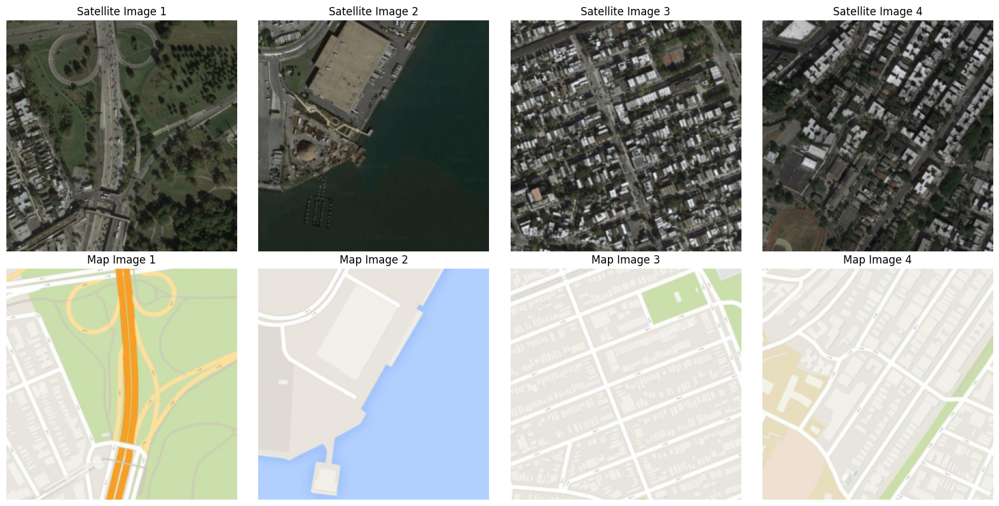

Starting training...
[Epoch 1/12] [Batch 0/274] [D_A loss: 1.6304] [D_B loss: 1.9531] [G loss: 32.7249]
[Epoch 1/12] [Batch 50/274] [D_A loss: 0.8977] [D_B loss: 0.3482] [G loss: 5.7813]
[Epoch 1/12] [Batch 100/274] [D_A loss: 0.3267] [D_B loss: 0.2453] [G loss: 7.2712]
[Epoch 1/12] [Batch 150/274] [D_A loss: 0.3072] [D_B loss: 0.2662] [G loss: 3.8599]
[Epoch 1/12] [Batch 200/274] [D_A loss: 0.3712] [D_B loss: 0.2605] [G loss: 4.5145]
[Epoch 1/12] [Batch 250/274] [D_A loss: 0.2951] [D_B loss: 0.1970] [G loss: 3.8905]


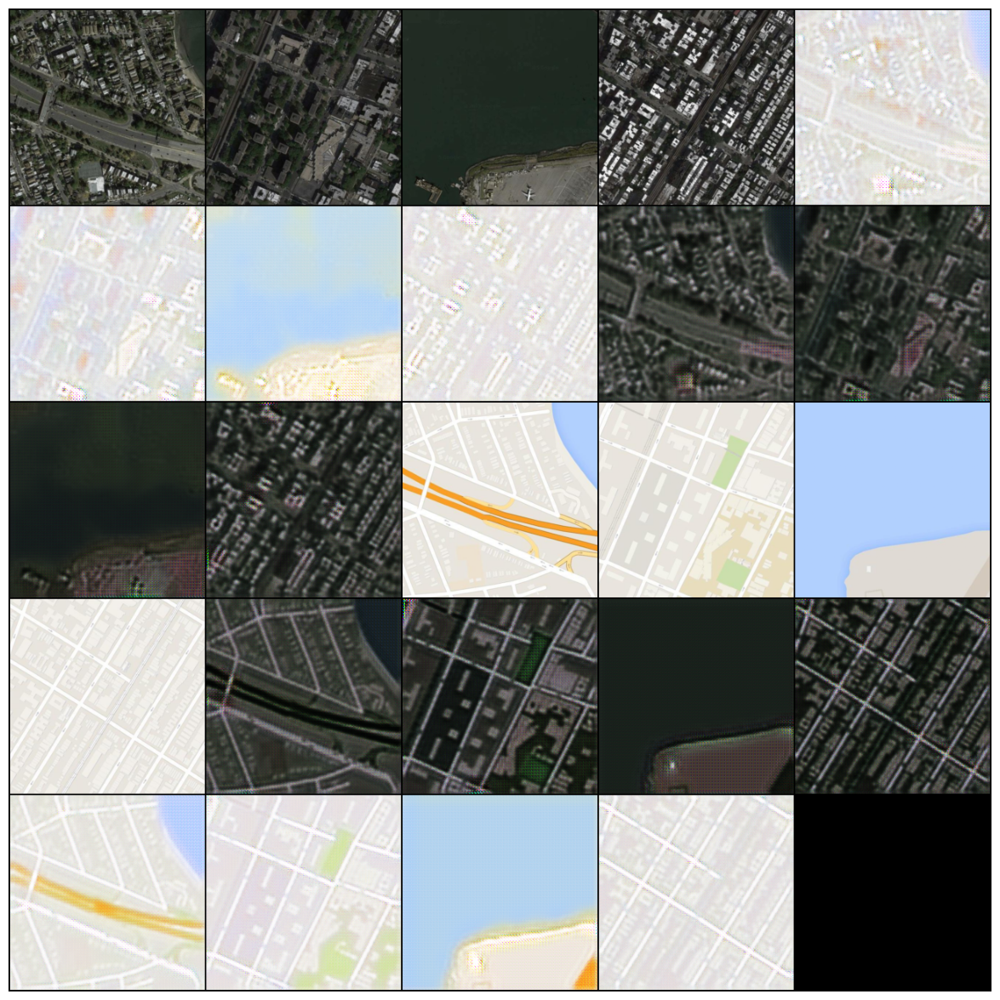

Epoch 1/12 completed in 694.26s
[Epoch 2/12] [Batch 0/274] [D_A loss: 0.2221] [D_B loss: 0.2400] [G loss: 6.1759]
[Epoch 2/12] [Batch 50/274] [D_A loss: 0.3142] [D_B loss: 0.1796] [G loss: 3.6814]
[Epoch 2/12] [Batch 100/274] [D_A loss: 0.3982] [D_B loss: 0.2032] [G loss: 3.2266]
[Epoch 2/12] [Batch 150/274] [D_A loss: 0.2819] [D_B loss: 0.2554] [G loss: 4.5848]
[Epoch 2/12] [Batch 200/274] [D_A loss: 0.2390] [D_B loss: 0.1702] [G loss: 4.8286]
[Epoch 2/12] [Batch 250/274] [D_A loss: 0.2233] [D_B loss: 0.3695] [G loss: 3.1217]


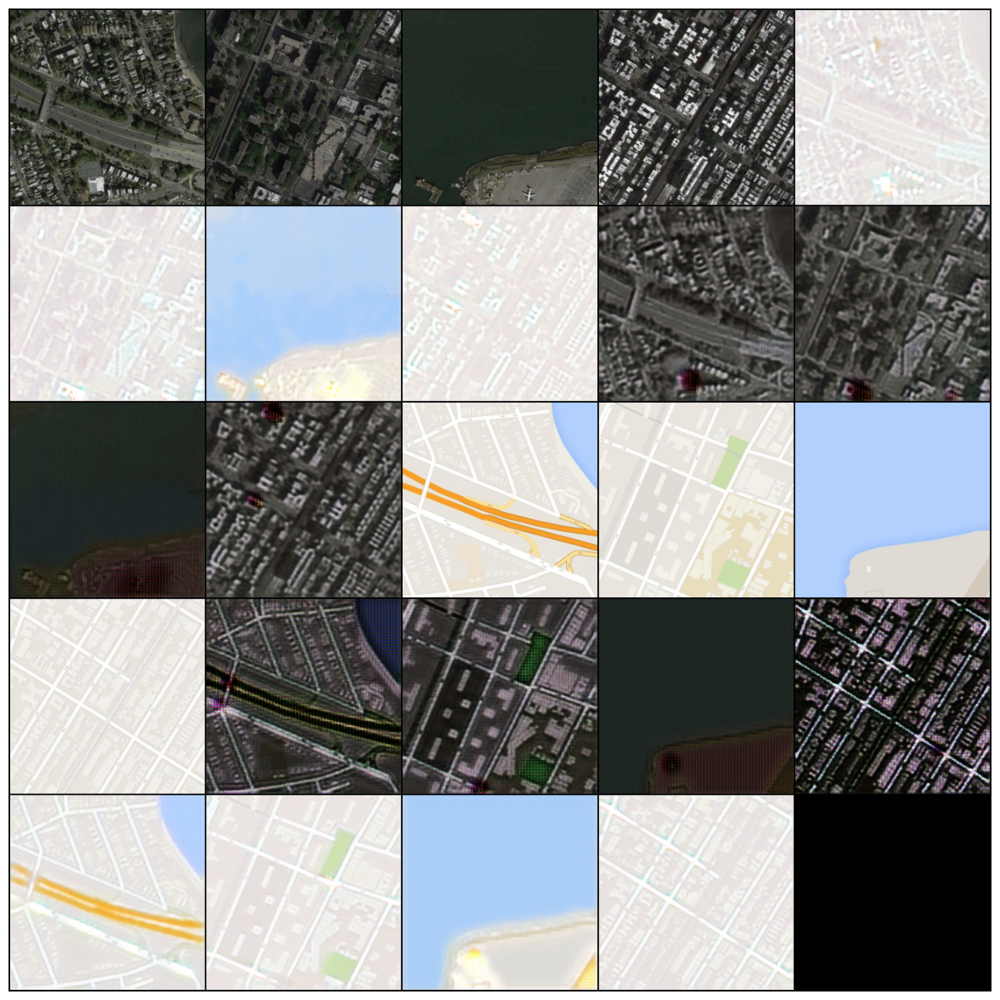

Epoch 2/12 completed in 693.71s
[Epoch 3/12] [Batch 0/274] [D_A loss: 0.2150] [D_B loss: 0.2070] [G loss: 5.8363]
[Epoch 3/12] [Batch 50/274] [D_A loss: 0.2524] [D_B loss: 0.1602] [G loss: 3.3899]
[Epoch 3/12] [Batch 100/274] [D_A loss: 0.2606] [D_B loss: 0.1450] [G loss: 3.0440]
[Epoch 3/12] [Batch 150/274] [D_A loss: 0.2411] [D_B loss: 0.1900] [G loss: 3.8123]
[Epoch 3/12] [Batch 200/274] [D_A loss: 0.2607] [D_B loss: 0.3063] [G loss: 3.4144]
[Epoch 3/12] [Batch 250/274] [D_A loss: 0.2089] [D_B loss: 0.1985] [G loss: 3.9768]


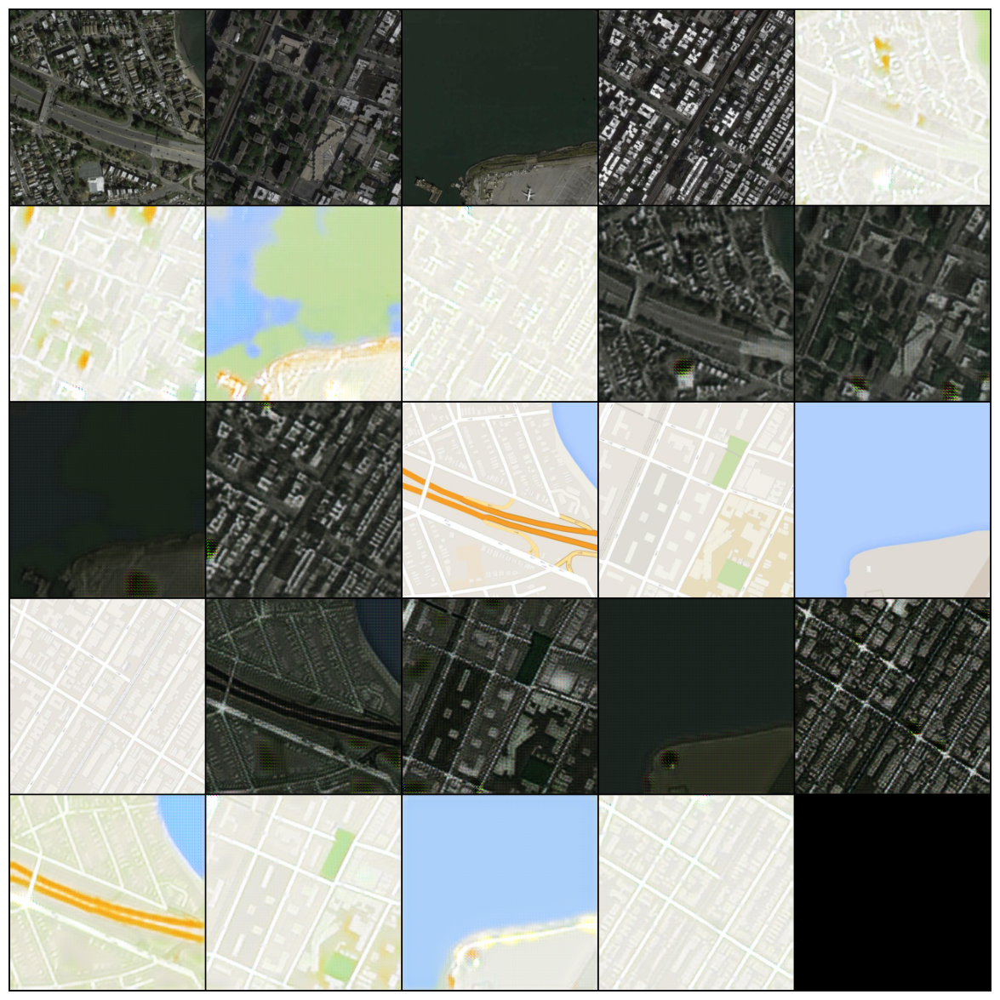

Epoch 3/12 completed in 701.42s
[Epoch 4/12] [Batch 0/274] [D_A loss: 0.1986] [D_B loss: 0.2717] [G loss: 3.3644]
[Epoch 4/12] [Batch 50/274] [D_A loss: 0.3111] [D_B loss: 0.2061] [G loss: 3.3359]
[Epoch 4/12] [Batch 100/274] [D_A loss: 0.2475] [D_B loss: 0.1750] [G loss: 3.4070]
[Epoch 4/12] [Batch 150/274] [D_A loss: 0.1946] [D_B loss: 0.1448] [G loss: 3.6263]
[Epoch 4/12] [Batch 200/274] [D_A loss: 0.2197] [D_B loss: 0.1601] [G loss: 6.8092]
[Epoch 4/12] [Batch 250/274] [D_A loss: 0.3975] [D_B loss: 0.1851] [G loss: 3.6413]


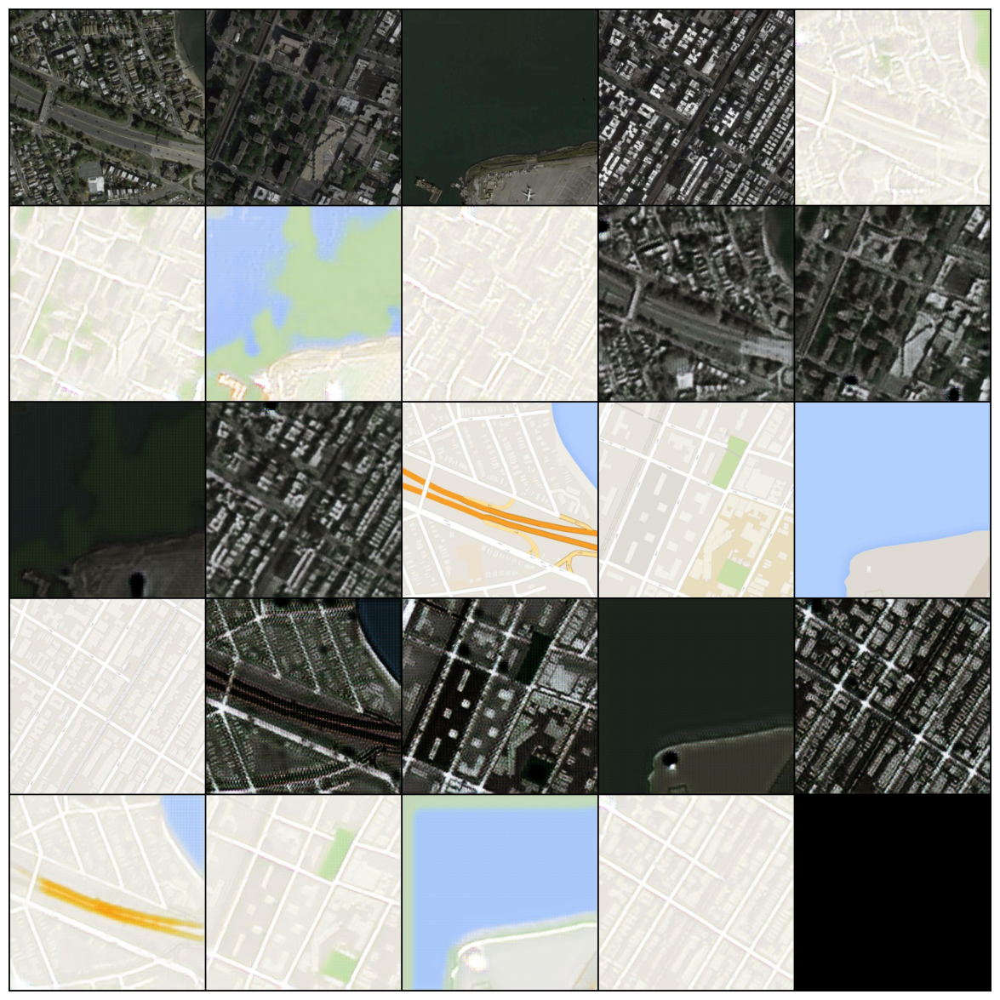

Epoch 4/12 completed in 703.05s
[Epoch 5/12] [Batch 0/274] [D_A loss: 0.1673] [D_B loss: 0.1318] [G loss: 5.2540]
[Epoch 5/12] [Batch 50/274] [D_A loss: 0.1684] [D_B loss: 0.1656] [G loss: 3.3469]
[Epoch 5/12] [Batch 100/274] [D_A loss: 0.1592] [D_B loss: 0.1574] [G loss: 3.5763]
[Epoch 5/12] [Batch 150/274] [D_A loss: 0.2657] [D_B loss: 0.1532] [G loss: 3.3841]
[Epoch 5/12] [Batch 200/274] [D_A loss: 0.2816] [D_B loss: 0.3336] [G loss: 3.3505]
[Epoch 5/12] [Batch 250/274] [D_A loss: 0.4322] [D_B loss: 0.1988] [G loss: 3.2649]


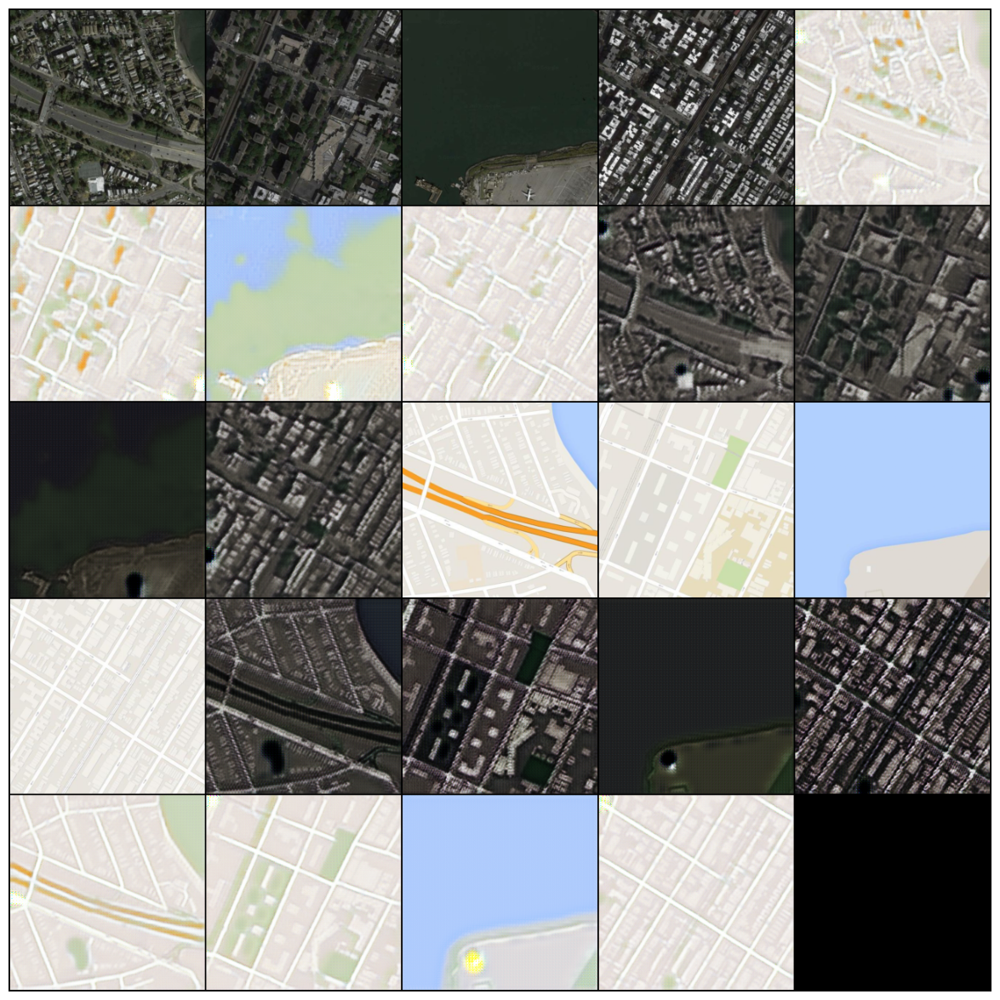

Epoch 5/12 completed in 690.39s
[Epoch 6/12] [Batch 0/274] [D_A loss: 0.1428] [D_B loss: 0.1852] [G loss: 3.2926]
[Epoch 6/12] [Batch 50/274] [D_A loss: 0.1394] [D_B loss: 0.2639] [G loss: 4.1775]
[Epoch 6/12] [Batch 100/274] [D_A loss: 0.1114] [D_B loss: 0.1988] [G loss: 3.8114]
[Epoch 6/12] [Batch 150/274] [D_A loss: 0.2147] [D_B loss: 0.2559] [G loss: 3.3385]
[Epoch 6/12] [Batch 200/274] [D_A loss: 0.1623] [D_B loss: 0.2054] [G loss: 2.8998]
[Epoch 6/12] [Batch 250/274] [D_A loss: 0.4225] [D_B loss: 0.2083] [G loss: 2.5389]


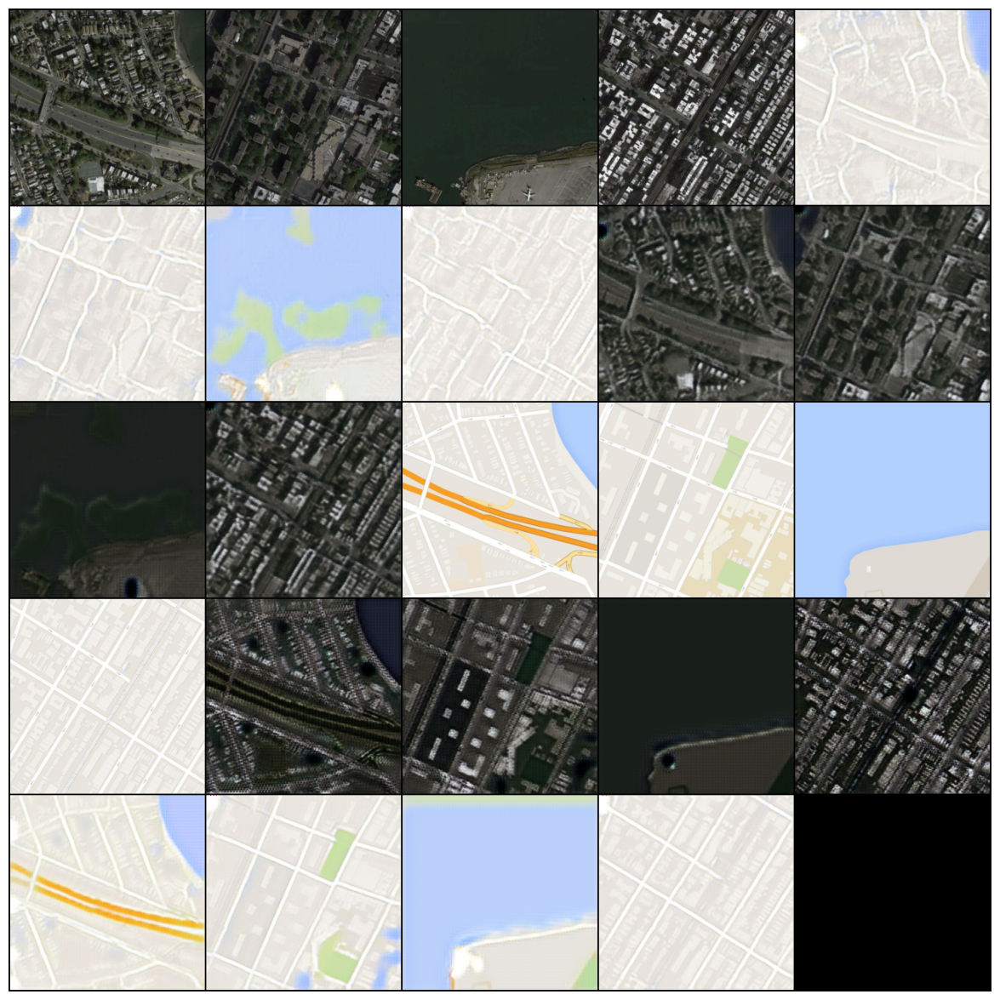

Epoch 6/12 completed in 688.81s
[Epoch 7/12] [Batch 0/274] [D_A loss: 0.2220] [D_B loss: 0.1400] [G loss: 3.6983]
[Epoch 7/12] [Batch 50/274] [D_A loss: 0.1332] [D_B loss: 0.1521] [G loss: 3.9684]
[Epoch 7/12] [Batch 100/274] [D_A loss: 0.1085] [D_B loss: 0.1567] [G loss: 2.8303]
[Epoch 7/12] [Batch 150/274] [D_A loss: 0.1610] [D_B loss: 0.2199] [G loss: 2.4393]
[Epoch 7/12] [Batch 200/274] [D_A loss: 1.8112] [D_B loss: 0.1933] [G loss: 5.0120]
[Epoch 7/12] [Batch 250/274] [D_A loss: 0.1965] [D_B loss: 0.2005] [G loss: 2.3978]


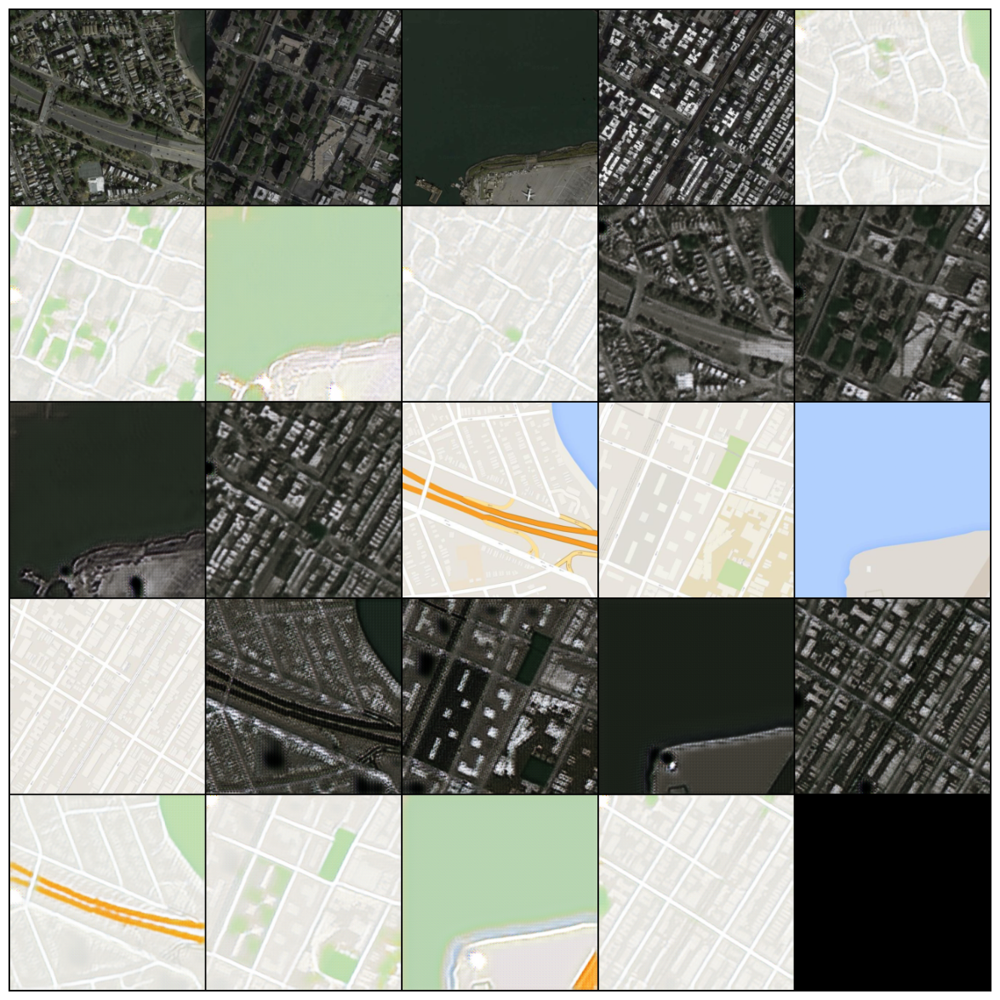

Epoch 7/12 completed in 688.93s
[Epoch 8/12] [Batch 0/274] [D_A loss: 0.1661] [D_B loss: 0.1691] [G loss: 2.5744]
[Epoch 8/12] [Batch 50/274] [D_A loss: 0.2616] [D_B loss: 0.1706] [G loss: 2.2242]
[Epoch 8/12] [Batch 100/274] [D_A loss: 0.1581] [D_B loss: 0.1812] [G loss: 4.9292]
[Epoch 8/12] [Batch 150/274] [D_A loss: 0.1995] [D_B loss: 0.2126] [G loss: 2.8780]
[Epoch 8/12] [Batch 200/274] [D_A loss: 0.0949] [D_B loss: 0.1840] [G loss: 3.1504]
[Epoch 8/12] [Batch 250/274] [D_A loss: 0.1173] [D_B loss: 0.1410] [G loss: 2.7752]


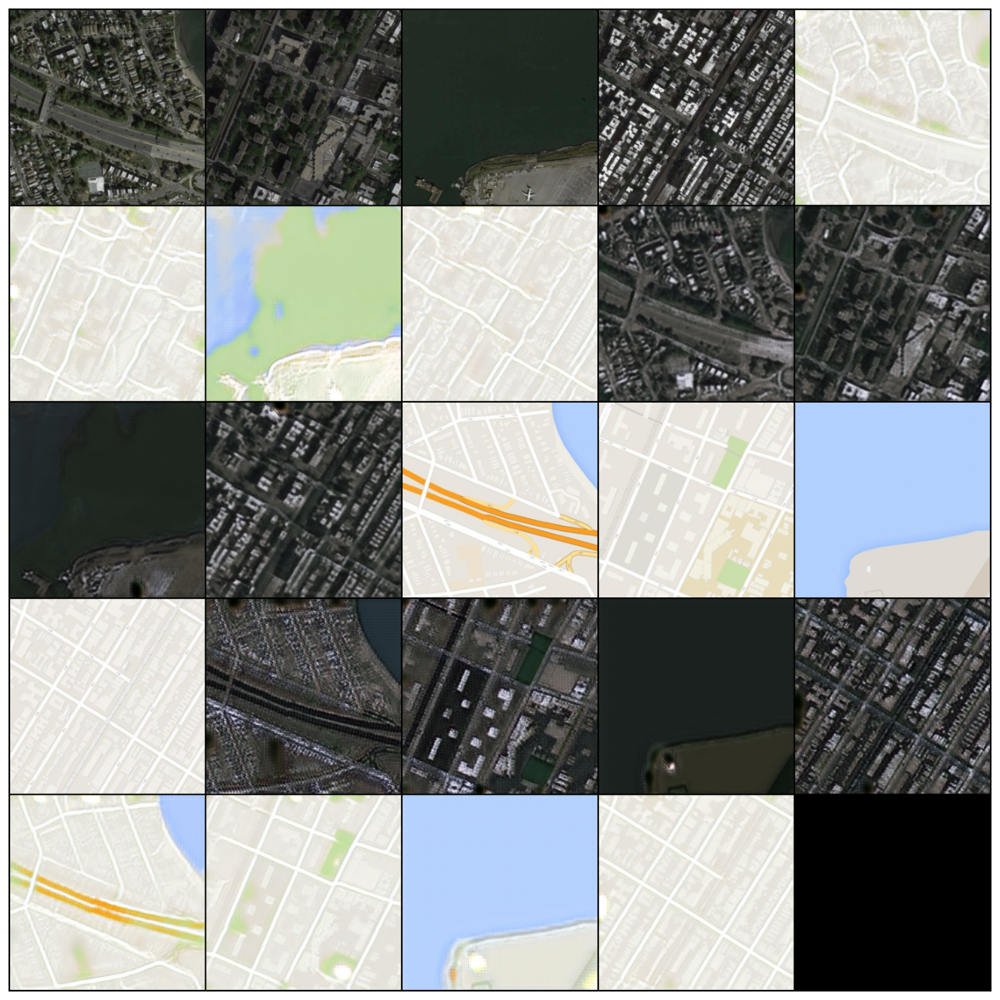

Epoch 8/12 completed in 688.29s
[Epoch 9/12] [Batch 0/274] [D_A loss: 0.1337] [D_B loss: 0.1319] [G loss: 3.0709]
[Epoch 9/12] [Batch 50/274] [D_A loss: 0.1701] [D_B loss: 0.1861] [G loss: 2.7634]
[Epoch 9/12] [Batch 100/274] [D_A loss: 0.1769] [D_B loss: 0.1684] [G loss: 2.3385]
[Epoch 9/12] [Batch 150/274] [D_A loss: 0.1475] [D_B loss: 0.2732] [G loss: 2.5458]
[Epoch 9/12] [Batch 200/274] [D_A loss: 0.1386] [D_B loss: 0.1822] [G loss: 2.1869]
[Epoch 9/12] [Batch 250/274] [D_A loss: 0.1814] [D_B loss: 0.1502] [G loss: 2.8774]


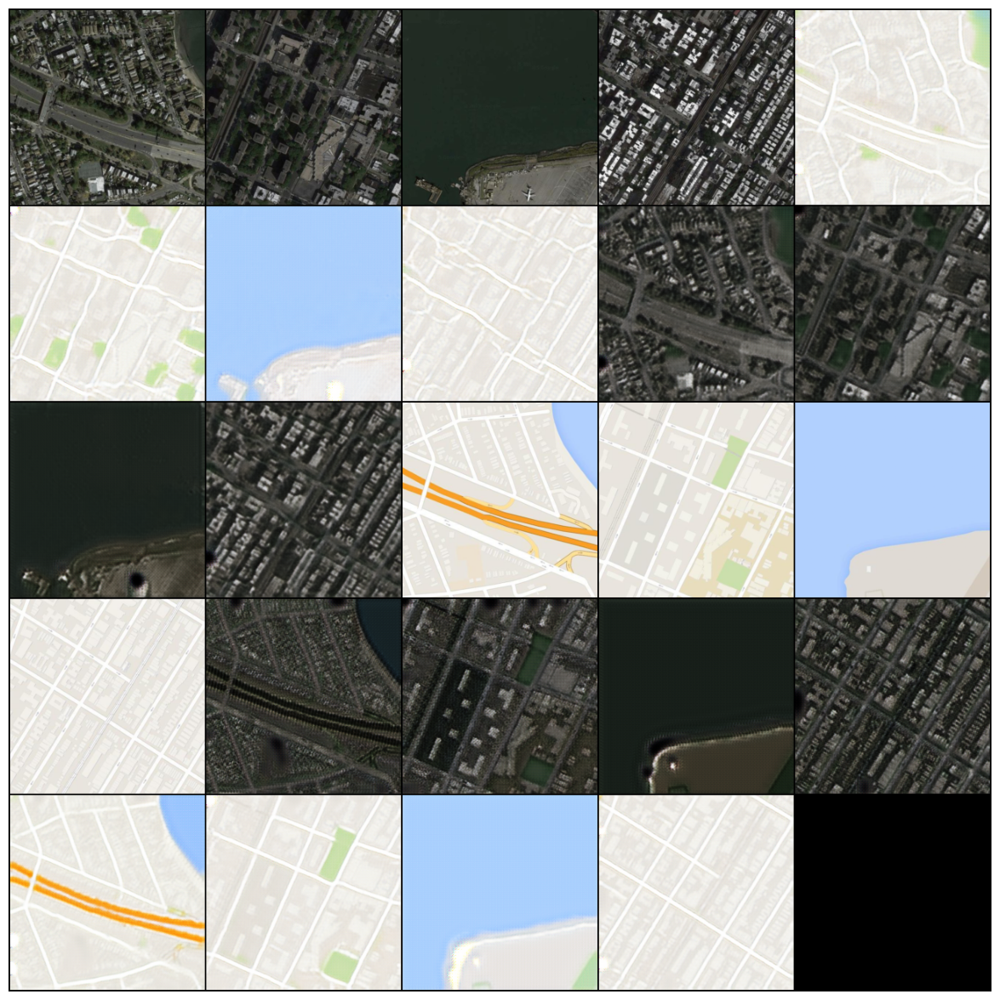

Epoch 9/12 completed in 694.91s
[Epoch 10/12] [Batch 0/274] [D_A loss: 0.2146] [D_B loss: 0.1331] [G loss: 1.9616]
[Epoch 10/12] [Batch 50/274] [D_A loss: 0.1878] [D_B loss: 0.1791] [G loss: 2.3091]
[Epoch 10/12] [Batch 100/274] [D_A loss: 0.1401] [D_B loss: 0.1748] [G loss: 2.4355]
[Epoch 10/12] [Batch 150/274] [D_A loss: 0.1577] [D_B loss: 0.1461] [G loss: 2.8412]
[Epoch 10/12] [Batch 200/274] [D_A loss: 0.1475] [D_B loss: 0.1615] [G loss: 2.6361]
[Epoch 10/12] [Batch 250/274] [D_A loss: 0.1626] [D_B loss: 0.1907] [G loss: 2.1447]


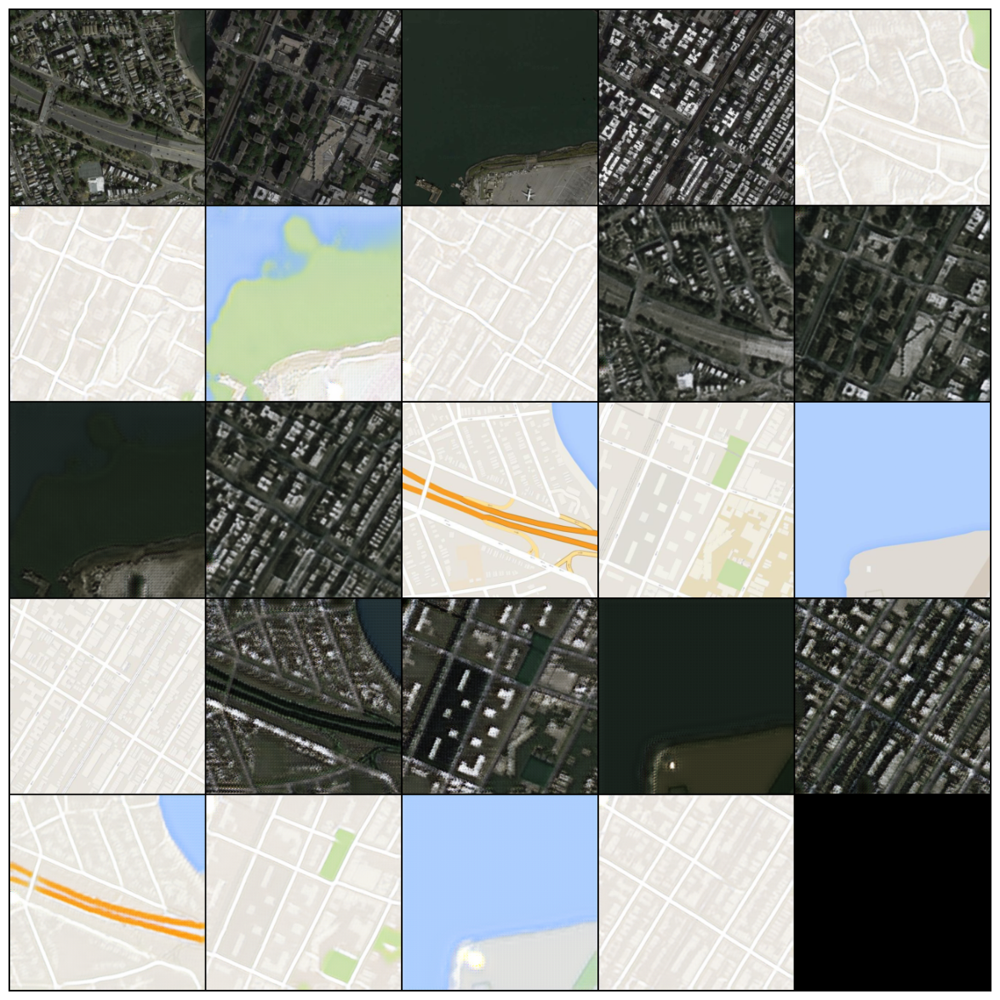

Epoch 10/12 completed in 690.32s
[Epoch 11/12] [Batch 0/274] [D_A loss: 0.1129] [D_B loss: 0.1091] [G loss: 2.4309]
[Epoch 11/12] [Batch 50/274] [D_A loss: 0.1947] [D_B loss: 0.1871] [G loss: 2.2953]
[Epoch 11/12] [Batch 100/274] [D_A loss: 0.1108] [D_B loss: 0.1319] [G loss: 4.8863]
[Epoch 11/12] [Batch 150/274] [D_A loss: 0.1884] [D_B loss: 0.1452] [G loss: 2.6106]
[Epoch 11/12] [Batch 200/274] [D_A loss: 0.1360] [D_B loss: 0.1105] [G loss: 2.6853]
[Epoch 11/12] [Batch 250/274] [D_A loss: 0.2380] [D_B loss: 0.1427] [G loss: 2.8575]


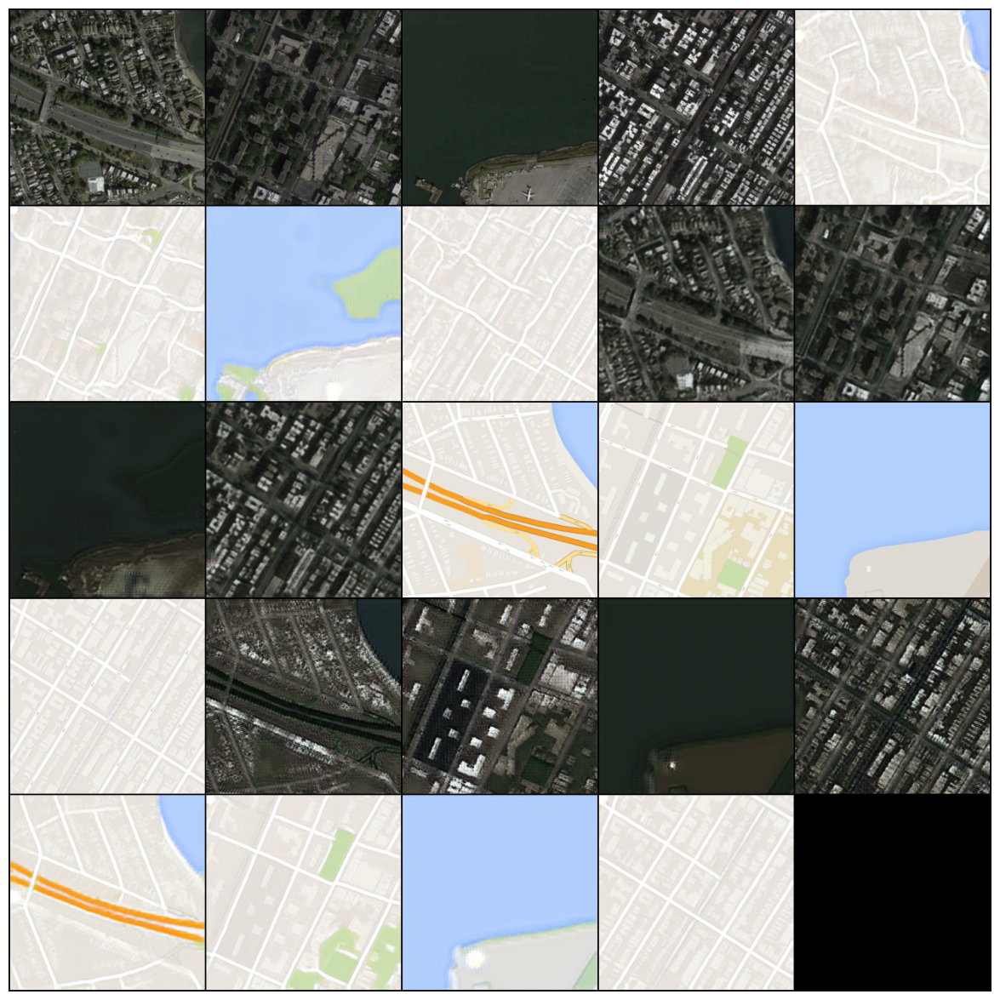

Epoch 11/12 completed in 688.26s
[Epoch 12/12] [Batch 0/274] [D_A loss: 0.1735] [D_B loss: 0.1178] [G loss: 4.5486]
[Epoch 12/12] [Batch 50/274] [D_A loss: 0.2055] [D_B loss: 0.1446] [G loss: 2.4245]
[Epoch 12/12] [Batch 100/274] [D_A loss: 0.1634] [D_B loss: 0.1191] [G loss: 2.3177]
[Epoch 12/12] [Batch 150/274] [D_A loss: 0.1847] [D_B loss: 0.1911] [G loss: 2.2565]
[Epoch 12/12] [Batch 200/274] [D_A loss: 0.1677] [D_B loss: 0.1357] [G loss: 4.7758]
[Epoch 12/12] [Batch 250/274] [D_A loss: 0.2098] [D_B loss: 0.0915] [G loss: 2.4713]


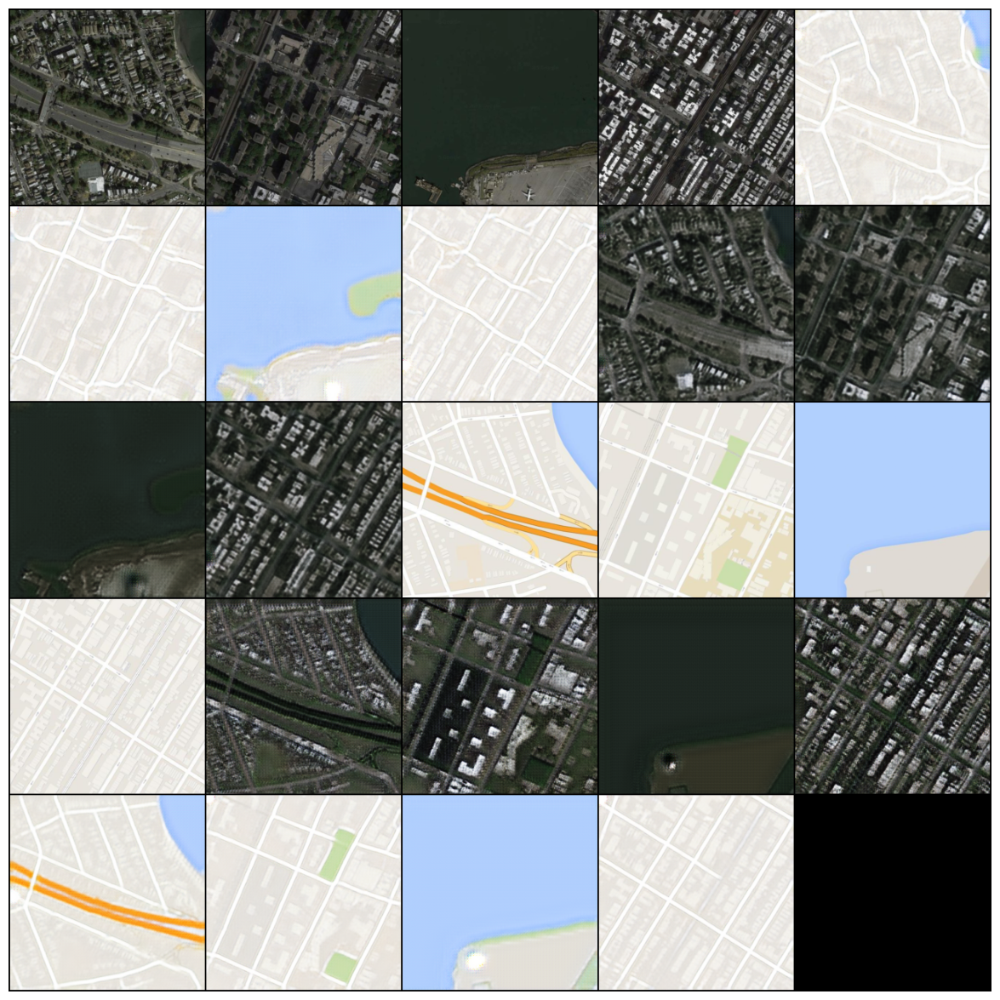

Epoch 12/12 completed in 688.25s


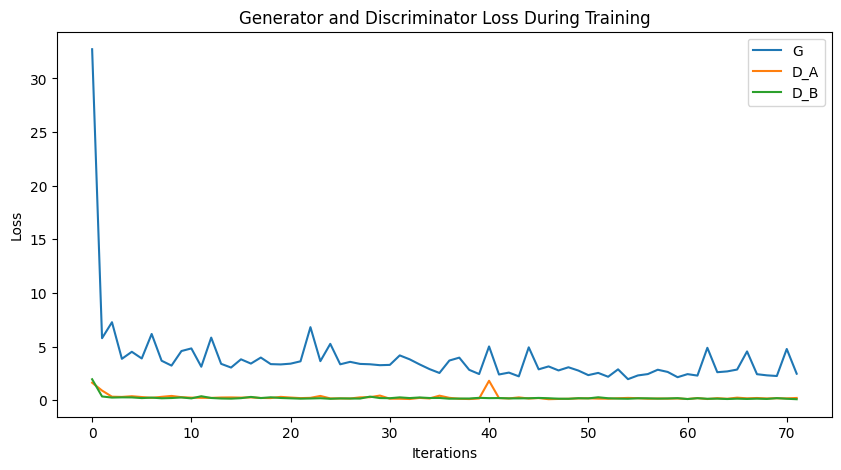

Testing models...


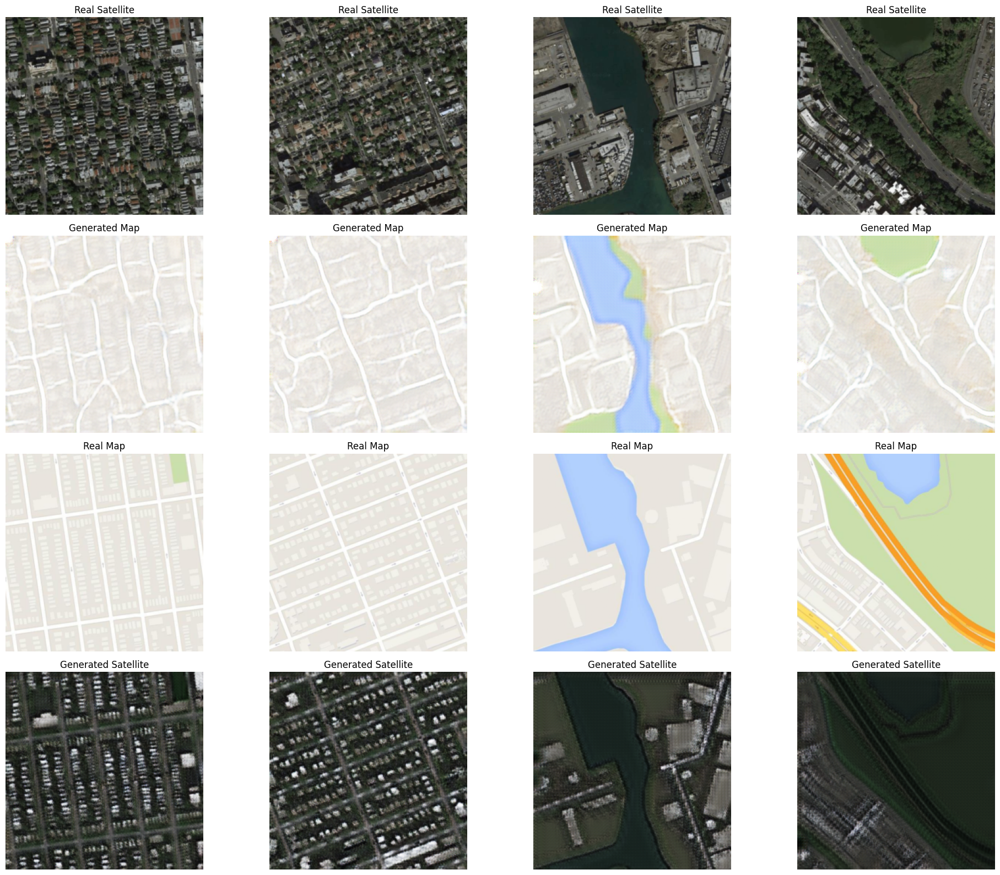

Done!


In [ ]:
if __name__ == "__main__":
    main()